# Chapter 8: Data Science Libraries




## Learn numpy


References

*   [NVidia ](https://devblogs.nvidia.com/numba-python-cuda-acceleration/)
*   [Numba](http://numba.pydata.org/)



### What is numpy?

* Low level multi-dimensional array library
* A programmers Excel
* The building blocks for many key Python libraries:  
  - Pandas
  - Sklearn
  - Tensorflow


### Hello World Numpy Workflow

In [1]:
import numpy as np

#### Make an array

In [2]:
a = np.arange(6).reshape(2, 3)

#### Print shape

In [3]:
a.shape

(2, 3)

#### Print size

In [4]:
a.size

6

#### Print type

In [5]:
a.dtype.name

'int64'

#### Print contents

In [6]:
a

array([[0, 1, 2],
       [3, 4, 5]])

### Create an Array

#### One Dimensional Array

In [7]:
a = np.array([2,4,6,8])
print(f"Shape {a.shape}")
print(f"Content: {a}")

Shape (4,)
Content: [2 4 6 8]


#### Two Dimensional Array

In [8]:
a = np.array([(2,4,6,8),(20,40,60,80)])
print(f"Shape: {a.shape}")
print(f"Content: {a}")

Shape: (2, 4)
Content: [[ 2  4  6  8]
 [20 40 60 80]]


#### Create Sequence of Numbers

In [9]:
a = np.arange(1,20)
print(f"Shape: {a.shape}")
print(f"Content: {a}")


Shape: (19,)
Content: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]


#### Create empty multi-dimensional array

In [10]:
a = np.zeros( (2,3) )
print(f"Shape: {a.shape}")
print(f"Content: {a}")

Shape: (2, 3)
Content: [[0. 0. 0.]
 [0. 0. 0.]]


## Learn sklearn

### Supervized Machine Learning:  Classification Modeling Workflow


#### Key Evaluation Terms



*  [Amazon ML Key Classification Metrics](https://docs.aws.amazon.com/machine-learning/latest/dg/binary-model-insights.html?icmpid=docs_machinelearning_console)
*  [sklearn classification metrics
](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.precision_recall_fscore_support.html)




*   **Precision**:  Measures the fraction of actual positives among those examples that are predicted as positive. The range is 0 to 1. A larger value indicates better predictive accuracy

*  ** Recall**:  Measures the fraction of actual positives that are predicted as positive. The range is 0 to 1. A larger value indicates better predictive accuracy

*   **F1-score**:  Weighted average of recall and precision


* **AUC**:  AUC measures the ability of the model to predict a higher score for positive examples as compared to negative examples

* **False Positive Rat**e:  The false positive rate (FPR) measures the false alarm rate or the fraction of actual negatives that are predicted as positive. The range is 0 to 1. A smaller value indicates better predictive accuracy





#### Digits Dataset

##### sklearn modeling

https://scikit-learn.org/stable/auto_examples/classification/plot_digits_classification.html

Classification report for classifier SVC(gamma=0.001):
              precision    recall  f1-score   support

           0       1.00      0.99      0.99        88
           1       0.99      0.97      0.98        91
           2       0.99      0.99      0.99        86
           3       0.98      0.87      0.92        91
           4       0.99      0.96      0.97        92
           5       0.95      0.97      0.96        91
           6       0.99      0.99      0.99        91
           7       0.96      0.99      0.97        89
           8       0.94      1.00      0.97        88
           9       0.93      0.98      0.95        92

    accuracy                           0.97       899
   macro avg       0.97      0.97      0.97       899
weighted avg       0.97      0.97      0.97       899


Confusion matrix:
[[87  0  0  0  1  0  0  0  0  0]
 [ 0 88  1  0  0  0  0  0  1  1]
 [ 0  0 85  1  0  0  0  0  0  0]
 [ 0  0  0 79  0  3  0  4  5  0]
 [ 0  0  0  0 88  0  0  0  0  4]
 [

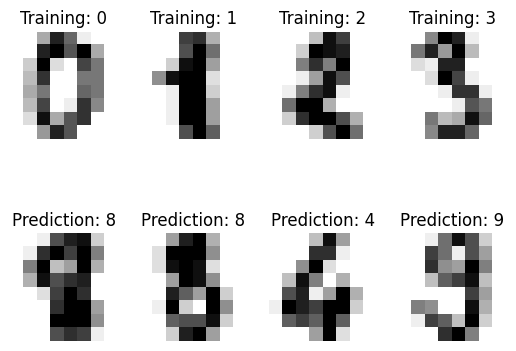

In [11]:
# Standard scientific Python imports
import matplotlib.pyplot as plt

# Import datasets, classifiers and performance metrics
from sklearn import datasets, svm, metrics

# The digits dataset
digits = datasets.load_digits()

# The data that we are interested in is made of 8x8 images of digits, let's
# have a look at the first 4 images, stored in the `images` attribute of the
# dataset.  If we were working from image files, we could load them using
# matplotlib.pyplot.imread.  Note that each image must have the same size. For these
# images, we know which digit they represent: it is given in the 'target' of
# the dataset.
images_and_labels = list(zip(digits.images, digits.target))
for index, (image, label) in enumerate(images_and_labels[:4]):
    plt.subplot(2, 4, index + 1)
    plt.axis('off')
    plt.imshow(image, cmap=plt.cm.gray_r, interpolation='nearest')
    plt.title('Training: %i' % label)

# To apply a classifier on this data, we need to flatten the image, to
# turn the data in a (samples, feature) matrix:
n_samples = len(digits.images)
data = digits.images.reshape((n_samples, -1))

# Create a classifier: a support vector classifier
classifier = svm.SVC(gamma=0.001)

# We learn the digits on the first half of the digits
classifier.fit(data[:n_samples // 2], digits.target[:n_samples // 2])

# Now predict the value of the digit on the second half:
expected = digits.target[n_samples // 2:]
predicted = classifier.predict(data[n_samples // 2:])

print("Classification report for classifier %s:\n%s\n"
      % (classifier, metrics.classification_report(expected, predicted)))
print("Confusion matrix:\n%s" % metrics.confusion_matrix(expected, predicted))

images_and_predictions = list(zip(digits.images[n_samples // 2:], predicted))
for index, (image, prediction) in enumerate(images_and_predictions[:4]):
    plt.subplot(2, 4, index + 5)
    plt.axis('off')
    plt.imshow(image, cmap=plt.cm.gray_r, interpolation='nearest')
    plt.title('Prediction: %i' % prediction)

plt.show()

#### Yellowbrick Confusion Matrix



http://www.scikit-yb.org/en/latest/api/classifier/confusion_matrix.html


In [12]:
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

from yellowbrick.classifier import ConfusionMatrix

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


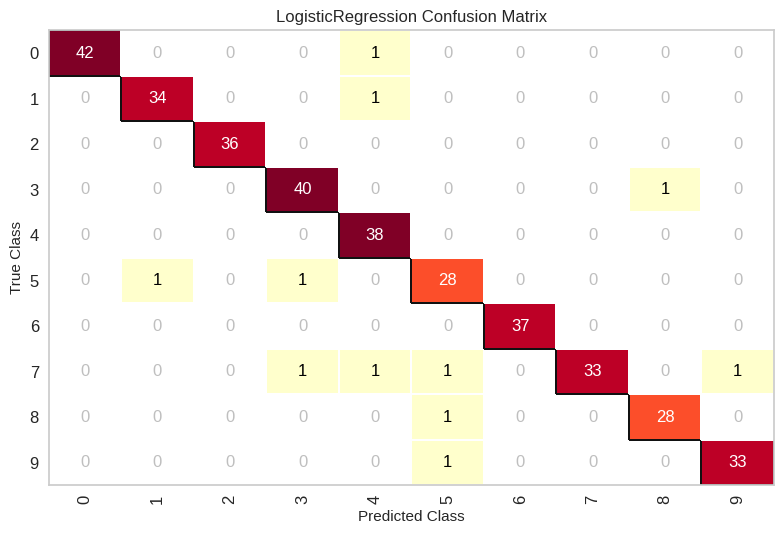

<Axes: title={'center': 'LogisticRegression Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [13]:

# We'll use the handwritten digits data set from scikit-learn.
# Each feature of this dataset is an 8x8 pixel image of a handwritten number.
# Digits.data converts these 64 pixels into a single array of features
digits = load_digits()
X = digits.data
y = digits.target

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size =0.2, random_state=1)

model = LogisticRegression()

# The ConfusionMatrix visualizer taxes a model
cm = ConfusionMatrix(model, classes=[0,1,2,3,4,5,6,7,8,9])

# Fit fits the passed model. This is unnecessary if you pass the visualizer a pre-fitted model
cm.fit(X_train, y_train)

# To create the ConfusionMatrix, we need some test data. Score runs predict() on the data
# and then creates the confusion_matrix from scikit-learn.
cm.score(X_test, y_test)

# How did we do?
cm.poof()

#### ROCAUC

http://www.scikit-yb.org/en/latest/api/classifier/rocauc.html


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


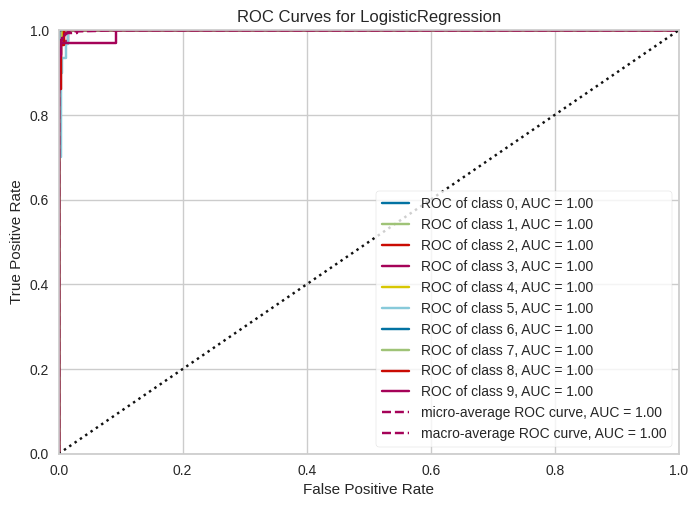

In [14]:
from yellowbrick.classifier import ROCAUC
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()
classes=[0,1,2,3,4,5,6,7,8,9]

# Instantiate the visualizer with the classification model
visualizer = ROCAUC(model, classes=classes)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
g = visualizer.poof()             # Draw/show/poof the data

### Supervized Machine Learning: Regression Modeling Workflow

#### Ingest

Source:  http://wiki.stat.ucla.edu/socr/index.php/SOCR_Data_MLB_HeightsWeights

In [15]:
import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/noahgift/functional_intro_to_python/master/data/mlb_weight_ht.csv")
df.head()


,Name,Team,Position,Height(inches),Weight(pounds),Age
0,Adam_Donachie,BAL,Catcher,74,180.0,22.99
1,Paul_Bako,BAL,Catcher,74,215.0,34.69
2,Ramon_Hernandez,BAL,Catcher,72,210.0,30.78
3,Kevin_Millar,BAL,First_Baseman,72,210.0,35.43
4,Chris_Gomez,BAL,First_Baseman,73,188.0,35.71


Find N/A

In [16]:
df.shape

(1034, 6)

In [17]:
df.isnull().values.any()

True

In [18]:
df = df.dropna()
df.isnull().values.any()

False

In [19]:
df.shape

(1033, 6)

#### Clean

In [20]:
df.rename(index=str,
             columns={"Height(inches)": "Height", "Weight(pounds)": "Weight"},
             inplace=True)
df.head()


<ipython-input-20-540c4495e702>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(index=str,


,Name,Team,Position,Height,Weight,Age
0,Adam_Donachie,BAL,Catcher,74,180.0,22.99
1,Paul_Bako,BAL,Catcher,74,215.0,34.69
2,Ramon_Hernandez,BAL,Catcher,72,210.0,30.78
3,Kevin_Millar,BAL,First_Baseman,72,210.0,35.43
4,Chris_Gomez,BAL,First_Baseman,73,188.0,35.71


#### EDA

In [21]:
df.describe()

,Height,Weight,Age
count,1033.000000,1033.000000,1033.000000
mean,73.698935,201.689255,28.737648
std,2.306330,20.991491,4.322298
min,67.000000,150.000000,20.900000
25%,72.000000,187.000000,25.440000
50%,74.000000,200.000000,27.930000
75%,75.000000,215.000000,31.240000
max,83.000000,290.000000,48.520000


#### Model

In [22]:
from sklearn import linear_model
from sklearn.model_selection import train_test_split


#### Create Features


In [23]:
var = df['Weight'].values
var.shape

(1033,)

In [24]:
y = df['Weight'].values #Target
y = y.reshape(-1, 1)
X = df['Height'].values #Feature(s)
X = X.reshape(-1,1)

In [25]:
#X = df[['Height', 'Age']].values

In [26]:
y.shape

(1033, 1)

#### Split data

In [27]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(826, 1) (826, 1)
(207, 1) (207, 1)


#### Fit the model

In [28]:
lm = linear_model.LinearRegression()
model = lm.fit(X_train, y_train)
predictions = lm.predict(X_test)

In [29]:
lm.predict?

Returns Numpy Array

In [30]:
type(predictions)

numpy.ndarray

#### Plot Predictions

Text(0, 0.5, 'Predicted Weight')

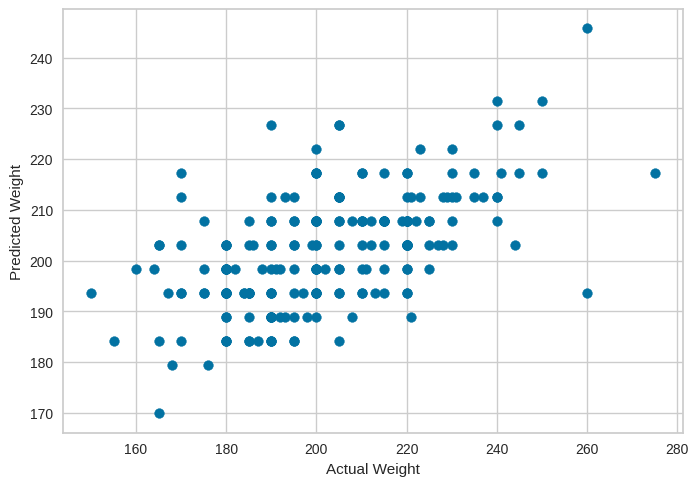

In [31]:
from matplotlib import pyplot as plt
plt.scatter(y_test, predictions)
plt.xlabel("Actual Weight")
plt.ylabel("Predicted Weight")

#### Print Accuracy of Linear Regression Model

In [32]:
model.score(X_test, y_test)

0.32756345712845003

#### Use Cross-Validation

In [33]:
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn import metrics

In [34]:
scores = cross_val_score(model, X, y, cv=6)
scores

array([0.29670427, 0.22459508, 0.29543549, 0.30012566, 0.19191046,
       0.34579806])

#### Plot Cross-validation Predictions

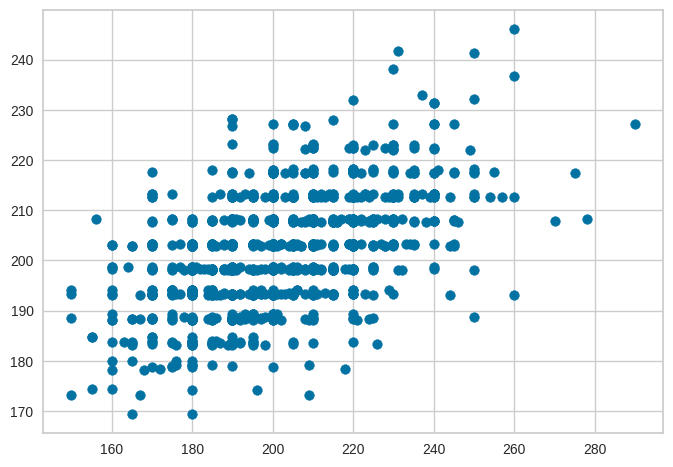

In [35]:
predictions = cross_val_predict(model, X, y, cv=6)
plt.scatter(y, predictions)

In [36]:
accuracy = metrics.r2_score(y, predictions)
accuracy

0.280770222008195

#### Conclusion

* Cross-Validation improved Accuracy
* Adding more data or more features could improve the model
* Major League Baseball may be a strange set to predict Weight
* Bigger Data Set here:  http://socr.ucla.edu/docs/resources/SOCR_Data/SOCR_Data_Dinov_020108_HeightsWeights.html


### Unsupervized Machine Learning:  Clustering

#### Ingest

In [37]:
import pandas as pd

df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole)
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola


In [38]:
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

#### Create Features to Cluster

In [39]:
df_cluster_features = df.drop("product", axis=1)

#### Scale the data

In [40]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
print(scaler.fit(df_cluster_features))
print(scaler.transform(df_cluster_features))

MinMaxScaler()
[[2.85700000e-01 6.42900000e-01 1.53063241e-01 6.89388819e-02
  0.00000000e+00 5.06782123e-01]
 [5.71400000e-01 1.78600000e-01 4.71343874e-02 2.06913199e-01
  6.02500000e-04 6.33675978e-01]
 [1.87500000e-01 5.78100000e-01 1.66205534e-01 1.70223038e-01
  6.87500000e-05 4.36433520e-01]
 ...
 [0.00000000e+00 1.33300000e-01 1.43577075e-01 3.44694410e-02
  1.87500000e-05 5.06391061e-02]
 [0.00000000e+00 1.62500000e-01 1.72430830e-01 3.44694410e-02
  1.87500000e-05 6.17318436e-02]
 [0.00000000e+00 0.00000000e+00 1.18577075e-02 3.44694410e-02
  0.00000000e+00 0.00000000e+00]]


#### Add Cluster Labels

In [41]:
from sklearn.cluster import KMeans

k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(scaler.transform(df_cluster_features))
df['cluster'] = kmeans.labels_
df.head()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product,cluster
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole),2
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix,2
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli,2
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix,2
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola,2


## Learn pandas

### Time Series Workflow

#### Ingest Zillow

In [42]:
import pandas as pd
pd.set_option('display.float_format', lambda x: '%.3f' % x)
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn as sns; sns.set(color_codes=True)
from sklearn.cluster import KMeans
color = sns.color_palette()
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
%matplotlib inline

In [43]:
df = pd.read_csv("https://raw.githubusercontent.com/noahgift/real_estate_ml/master/data/Zip_Zhvi_SingleFamilyResidence_2018.csv")
df[["City", "State"]].head()


,City,State
0,Chicago,IL
1,Katy,TX
2,Chicago,IL
3,El Paso,TX
4,Katy,TX


#### EDA

In [44]:
df[["1996-06"]].describe()

,1996-06
count,14338.000
mean,116123.051
std,85413.118
min,11600.000
25%,66925.000
50%,96750.000
75%,140600.000
max,3729600.000


#### Clean Up DataFrame
Rename RegionName to ZipCode and Change Zip Code to String

In [45]:
df.rename(columns={"RegionName":"ZipCode"}, inplace=True)
df["ZipCode"]=df["ZipCode"].map(lambda x: "{:.0f}".format(x))
df["RegionID"]=df["RegionID"].map(lambda x: "{:.0f}".format(x))
df[["1996-06"]].head()

,1996-06
0,336500.000
1,212200.000
2,503100.000
3,77300.000
4,95800.000


In [46]:
median_prices = df.median()
#sf_prices = df["City"] == "San Francisco".median()


<ipython-input-46-119bbf483686>:1: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  median_prices = df.median()


**Median USA Prices December, 2018**

In [47]:
median_prices.tail()

2018-08   196900.000
2018-09   198100.000
2018-10   199600.000
2018-11   201100.000
2018-12   202150.000
dtype: float64

In [48]:
sf_df = df[df["City"] == "San Francisco"].median()
df_comparison = pd.concat([sf_df,median_prices], axis=1)
df_comparison.columns = ["San Francisco","Median USA"]
df_comparison.tail()


<ipython-input-48-bd23e19a247a>:1: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  sf_df = df[df["City"] == "San Francisco"].median()


,San Francisco,Median USA
2018-08,1828600.000,196900.000
2018-09,1823200.000,198100.000
2018-10,1823700.000,199600.000
2018-11,1813400.000,201100.000
2018-12,1806000.000,202150.000


#### Transpose


In [49]:
df_transposed = df.transpose()
#df_transposed.head(15)
df_transposed.columns


RangeIndex(start=0, stop=15508, step=1)

#### Create Cities DataFrame

In [50]:
cities = df_transposed.iloc[2].values

In [51]:
cities_df = df_transposed.drop(df_transposed.index[:7])
cities_df.columns = cities
#cities_df.head()

#### Create time series

In [52]:
from pandas.plotting import autocorrelation_plot


In [53]:
sf_values = cities_df.iloc[:, 9].values
index = pd.DatetimeIndex(cities_df.index.values)
sf_data = pd.Series(sf_values, index=index)


#### autocorrelation plot

Reference:  https://pandas.pydata.org/pandas-docs/stable/user_guide/visualization.html#visualization-autocorrelation

<Axes: xlabel='Lag', ylabel='Autocorrelation'>

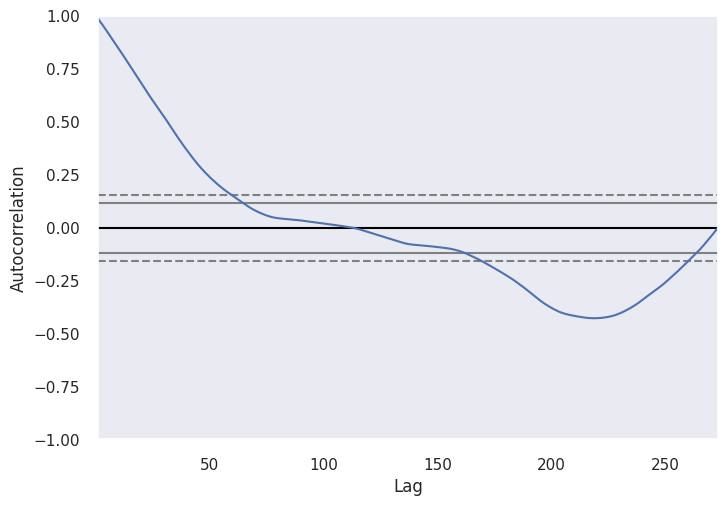

In [54]:
autocorrelation_plot(sf_data)

In [55]:
sf_data.tail()

2018-08-01    3993000
2018-09-01    3999000
2018-10-01    4014600
2018-11-01    4009500
2018-12-01    4016600
dtype: object

#### Simple Plot

<Axes: >

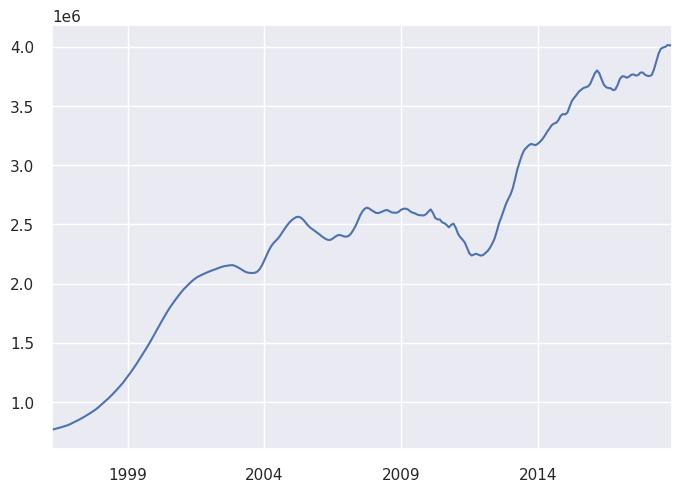

In [56]:
sf_data.plot()

### DataFrame Workflow

#### Ingest

In [57]:
import pandas as pd

In [58]:
df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.570,64.290,14.290,3.570,0.000,2267.850,Banana Chips Sweetened (Whole)
2,57.140,17.860,3.570,17.860,1.224,2835.700,Organic Salted Nut Mix
3,18.750,57.810,15.620,14.060,0.140,1953.040,Organic Muesli
4,36.670,36.670,3.330,16.670,1.608,2336.910,Zen Party Mix
5,18.180,60.000,21.820,14.550,0.023,1976.370,Cinnamon Nut Granola


#### EDA

In [59]:
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

#### Rows and Attributes

In [60]:
df.shape

(45026, 7)

#### First Five Columns

In [61]:
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.570,64.290,14.290,3.570,0.000,2267.850,Banana Chips Sweetened (Whole)
2,57.140,17.860,3.570,17.860,1.224,2835.700,Organic Salted Nut Mix
3,18.750,57.810,15.620,14.060,0.140,1953.040,Organic Muesli
4,36.670,36.670,3.330,16.670,1.608,2336.910,Zen Party Mix
5,18.180,60.000,21.820,14.550,0.023,1976.370,Cinnamon Nut Granola


#### Descriptive Statistics

In [62]:
df.describe()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g
count,45026.000,45026.000,45026.000,45026.000,45026.000,45026.000
mean,10.766,34.054,16.005,6.617,1.470,1111.286
std,14.930,29.557,21.496,7.926,12.795,791.609
min,0.000,0.000,-1.200,-3.570,0.000,0.000
25%,0.000,7.440,1.570,0.000,0.064,334.520
50%,3.170,22.390,5.880,4.000,0.635,1121.540
75%,17.860,61.540,23.080,9.520,1.440,1678.460
max,100.000,100.000,100.000,100.000,2032.000,4475.000


#### Correlations

In [63]:
df.corr()

<ipython-input-63-2f6f6606aa2c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g
fat_100g,1.000,-0.051,-0.068,0.383,-0.003,0.768
carbohydrates_100g,-0.051,1.000,0.669,-0.097,-0.011,0.580
sugars_100g,-0.068,0.669,1.000,-0.277,-0.030,0.327
proteins_100g,0.383,-0.097,-0.277,1.000,0.016,0.391
salt_100g,-0.003,-0.011,-0.030,0.016,1.000,-0.007
energy_100g,0.768,0.580,0.327,0.391,-0.007,1.000


#### Filtering by Quantiles

##### Find fatty foods in the 98th percentile

In [64]:
high_fat_df = df[df.fat_100g > df.fat_100g.quantile(.98)]
high_fat_text = high_fat_df['product'].values
len(high_fat_text)

878

In [65]:
high_fat_text[0]

'Organic Salted Nut Mix'

##### Find protein foods in the 98th percentile

In [66]:
high_protein_df = df[df.proteins_100g > df.proteins_100g.quantile(.98)]
high_protein_text = high_protein_df['product'].values
len(high_protein_text)

896

In [67]:
high_protein_text[0]

'Organic Yellow Split Peas'

## Learn tensorflow

## Use seaborn for 2D plots

### Faceted Distribution Plots

Generate distributions based on energy type

<ipython-input-68-652d4ef62143>:5: MatplotlibDeprecationWarning: mplDeprecation was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use matplotlib.MatplotlibDeprecationWarning instead.
  warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)
<ipython-input-68-652d4ef62143>:14: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.proteins_100g, color="b", ax=axes[0, 0])
<ipython-input-68-652d4ef62143>:15: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `his

<Axes: xlabel='carbohydrates_100g', ylabel='Density'>

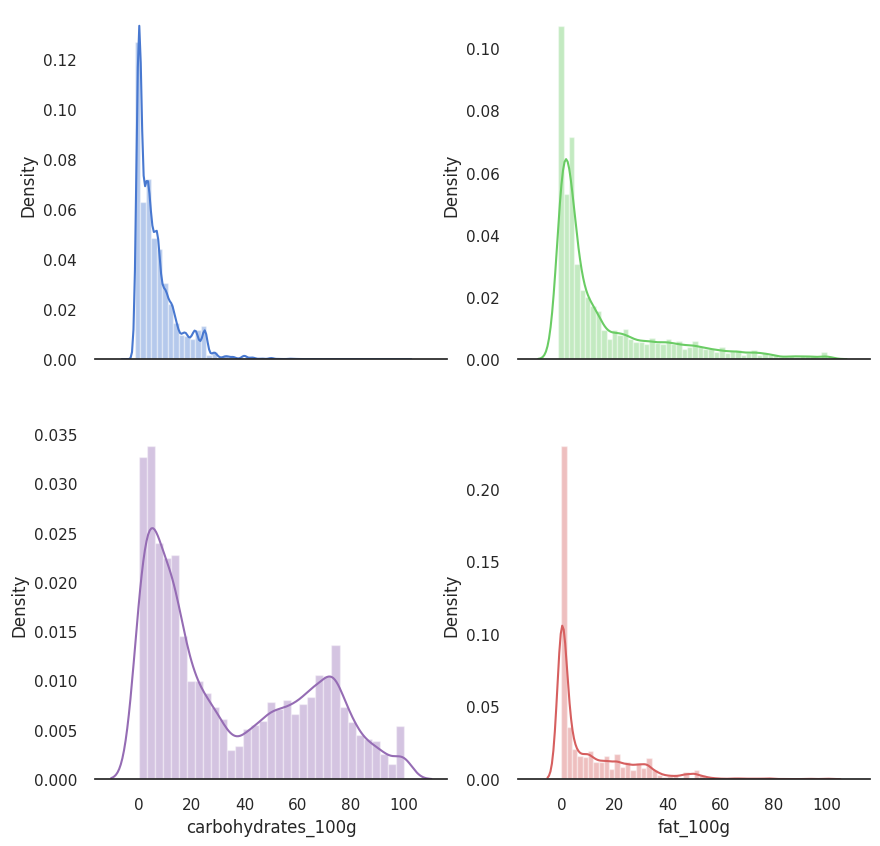

In [68]:
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)
sns.set(style="white", palette="muted", color_codes=True)


# Set up the matplotlib figure
f, axes = plt.subplots(2, 2, figsize=(10, 10), sharex=True)
sns.despine(left=True)

# Plot each distribution on the 4 points
sns.distplot(df.proteins_100g, color="b", ax=axes[0, 0])
sns.distplot(df.sugars_100g, color="g", ax=axes[0, 1])
sns.distplot(df.fat_100g, color="r", ax=axes[1, 1])
sns.distplot(df.carbohydrates_100g, color="m", ax=axes[1, 0])

### Pairplot

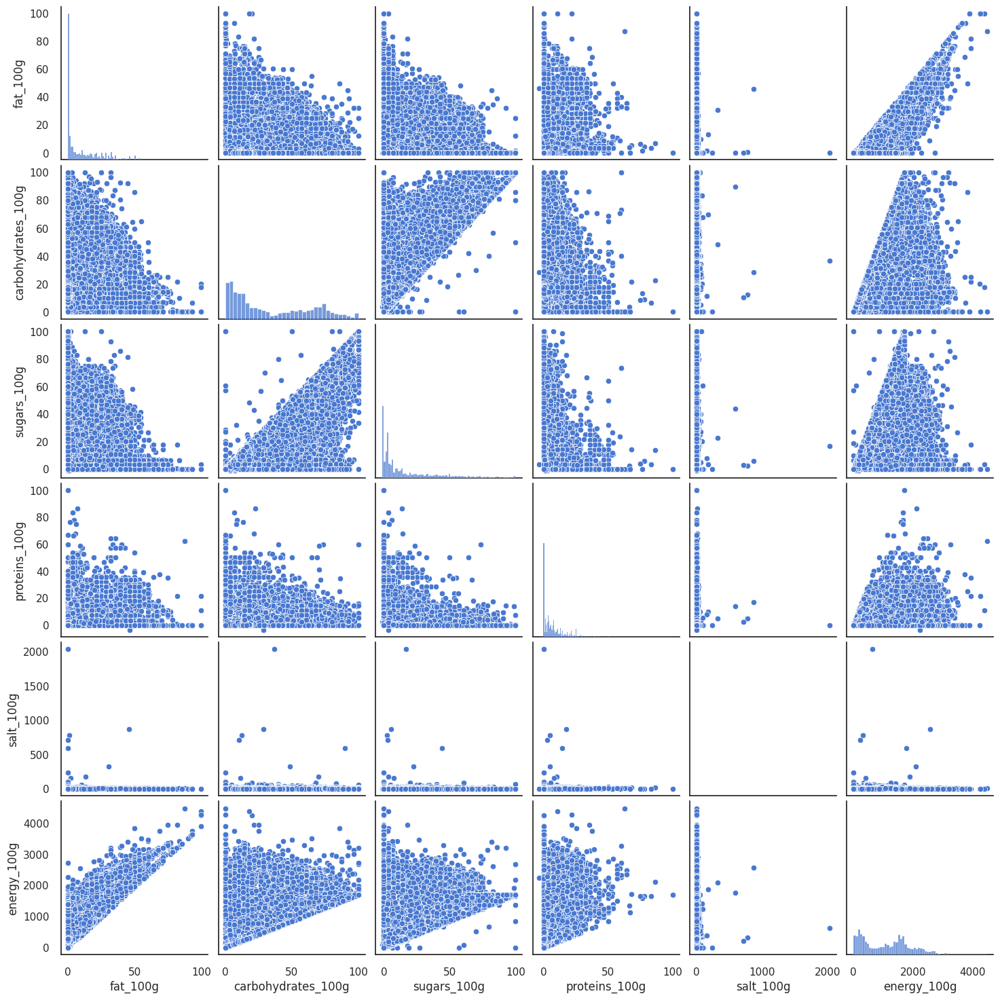

In [69]:
import seaborn as sns
sns.pairplot(df)

### lmplot


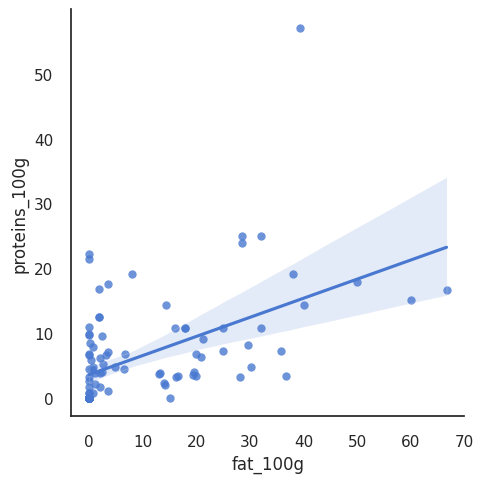

In [70]:
import seaborn as sns
sns.lmplot(x="fat_100g", y="proteins_100g",  data=df.sample(100))

### heatmap

<ipython-input-71-aa4f4450a243>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr())


<Axes: >

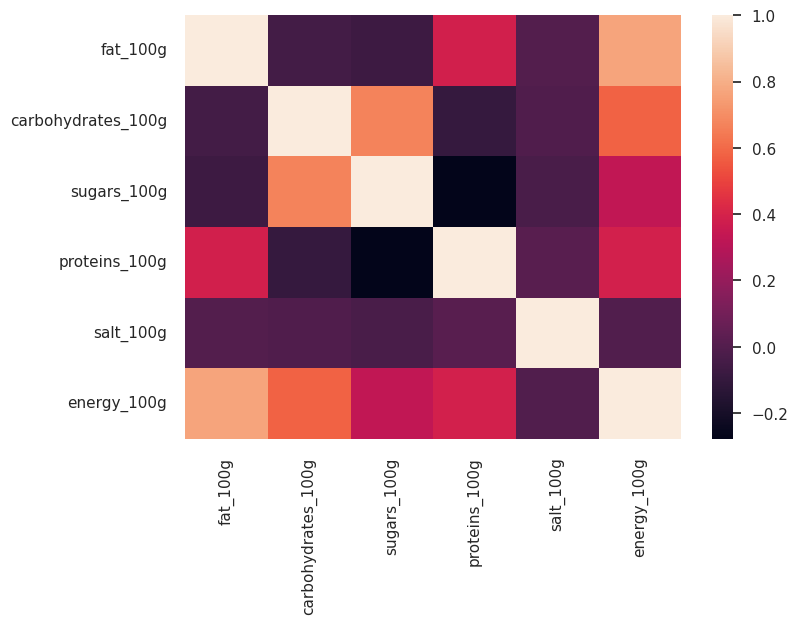

In [71]:
sns.heatmap(df.corr())

## Use Plotly for interactive plots

### Unsupervized Machine Learning:  Clustering

#### Ingest

In [72]:
import pandas as pd

df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.570,64.290,14.290,3.570,0.000,2267.850,Banana Chips Sweetened (Whole)
2,57.140,17.860,3.570,17.860,1.224,2835.700,Organic Salted Nut Mix
3,18.750,57.810,15.620,14.060,0.140,1953.040,Organic Muesli
4,36.670,36.670,3.330,16.670,1.608,2336.910,Zen Party Mix
5,18.180,60.000,21.820,14.550,0.023,1976.370,Cinnamon Nut Granola


In [73]:
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

#### Create Features to Cluster

In [74]:
df_cluster_features = df.drop("product", axis=1)

#### Scale the data

In [75]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
print(scaler.fit(df_cluster_features))
print(scaler.transform(df_cluster_features))

MinMaxScaler()
[[2.85700000e-01 6.42900000e-01 1.53063241e-01 6.89388819e-02
  0.00000000e+00 5.06782123e-01]
 [5.71400000e-01 1.78600000e-01 4.71343874e-02 2.06913199e-01
  6.02500000e-04 6.33675978e-01]
 [1.87500000e-01 5.78100000e-01 1.66205534e-01 1.70223038e-01
  6.87500000e-05 4.36433520e-01]
 ...
 [0.00000000e+00 1.33300000e-01 1.43577075e-01 3.44694410e-02
  1.87500000e-05 5.06391061e-02]
 [0.00000000e+00 1.62500000e-01 1.72430830e-01 3.44694410e-02
  1.87500000e-05 6.17318436e-02]
 [0.00000000e+00 0.00000000e+00 1.18577075e-02 3.44694410e-02
  0.00000000e+00 0.00000000e+00]]


#### Add Cluster Labels

In [76]:
from sklearn.cluster import KMeans

k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(scaler.transform(df_cluster_features))
df['cluster'] = kmeans.labels_
df.head()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product,cluster
0,28.570,64.290,14.290,3.570,0.000,2267.850,Banana Chips Sweetened (Whole),0
2,57.140,17.860,3.570,17.860,1.224,2835.700,Organic Salted Nut Mix,0
3,18.750,57.810,15.620,14.060,0.140,1953.040,Organic Muesli,0
4,36.670,36.670,3.330,16.670,1.608,2336.910,Zen Party Mix,0
5,18.180,60.000,21.820,14.550,0.023,1976.370,Cinnamon Nut Granola,0


### 2D Plots

In [77]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)

In [78]:
from plotly.offline import init_notebook_mode
enable_plotly_in_cell()
init_notebook_mode(connected=False)

import cufflinks as cf
cf.go_offline()
df.sample(1000).iplot(kind='bubble',
                      size='energy_100g',
                      mode='markers',
                      x='fat_100g',
                      y='proteins_100g',
                      xTitle='Fat',
                      yTitle='Protein',
                      text="product")

### 3D ClusterPlot

#### Protein-Fat-Carb 3D Plot

In [79]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
enable_plotly_in_cell()


trace1 = go.Scatter3d(
    x=df["fat_100g"],
    y=df["carbohydrates_100g"],
    z=df["proteins_100g"],
    mode='markers',
    text=df["product"],
    marker=dict(
        size=12,
        color=df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Protein-Fat-Carb:  Food Energy Types",
    scene = dict(
        xaxis = dict(title='X: Fat Content-100g'),
        yaxis = dict(title="Y:  Carbohydrate Content-100g"),
        zaxis = dict(title="Z:  Protein Content-100g"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

#### Sugar-Salt-Carb-3D Plot

In [80]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
enable_plotly_in_cell()


trace1 = go.Scatter3d(
    x=df["sugars_100g"],
    y=df["carbohydrates_100g"],
    z=df["salt_100g"],
    mode='markers',
    text=df["product"],
    marker=dict(
        size=12,
        color=df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Sugar, Carb, Salt:  Food Energy Types",
    scene = dict(
        xaxis = dict(title='X: Sugar Content-100g'),
        yaxis = dict(title="Y: Carbohydrate Content-100g"),
        zaxis = dict(title="Z: Salt Content-100g"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

## Specialized Visualization Libraries

### Yellowbrick


#### Visualize Regression Lasso (Regression) Model Accuracy with Yellowbrick

Note, uses Lasso Regression

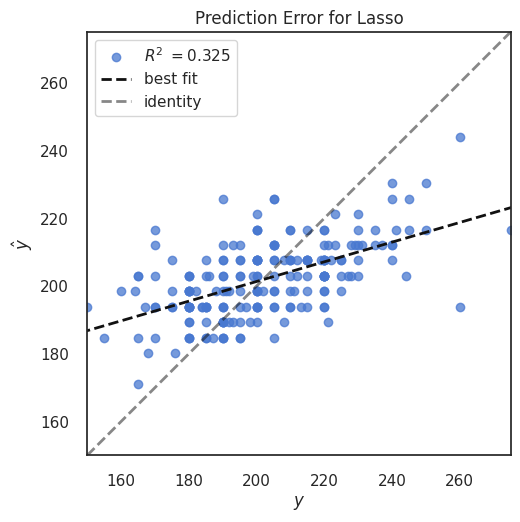

In [81]:
from yellowbrick.regressor import PredictionError
from sklearn.linear_model import Lasso

lasso = Lasso()
visualizer = PredictionError(lasso)
visualizer.fit(X_train, y_train) # Fit the training data to the visualizer
visualizer.score(X_test, y_test) # Evaluate the model on the test data
g = visualizer.poof()            # Draw/show/poof the data

#### Visualize cross-validated scores for Linear regression model

See this:  http://www.scikit-yb.org/en/latest/api/model_selection/cross_validation.html

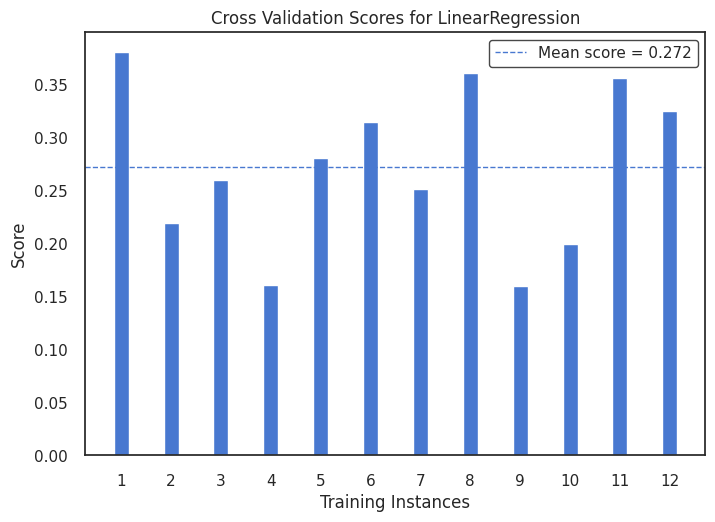

<Axes: title={'center': 'Cross Validation Scores for LinearRegression'}, xlabel='Training Instances', ylabel='Score'>

In [82]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import KFold
from yellowbrick.model_selection import CVScores

# Create a new figure and axes
_, ax = plt.subplots()
cv = KFold(12)

oz = CVScores(
    linear_model.LinearRegression(), ax=ax, cv=cv, scoring='r2'
)

oz.fit(X, y)
oz.poof()

### Word Cloud

In [83]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

#### High protein foods

Find protein foods in the 98th percentile

In [84]:
high_protein_df = df[df.proteins_100g > df.proteins_100g.quantile(.98)]
high_protein_text = high_protein_df['product'].values
len(high_protein_text)

896

Word Cloud High Protein

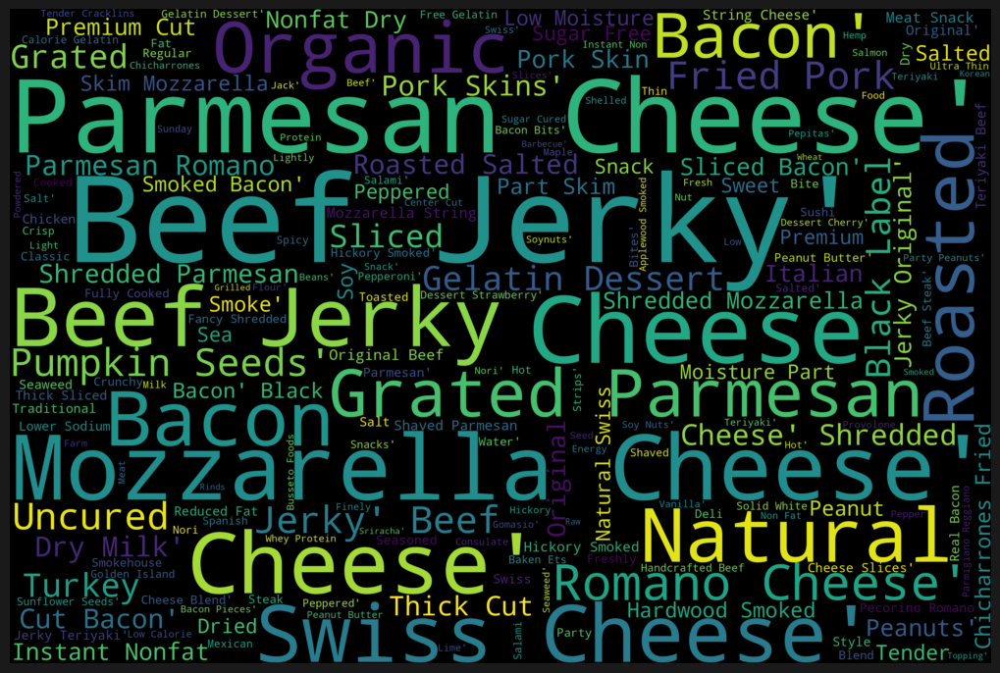

In [85]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_protein_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#### High fat foods

Find fatty foods in the 98th percentile

In [86]:
high_fat_df = df[df.fat_100g > df.fat_100g.quantile(.98)]
high_fat_text = high_fat_df['product'].values
len(high_fat_text)

878

Word Cloud High Fat

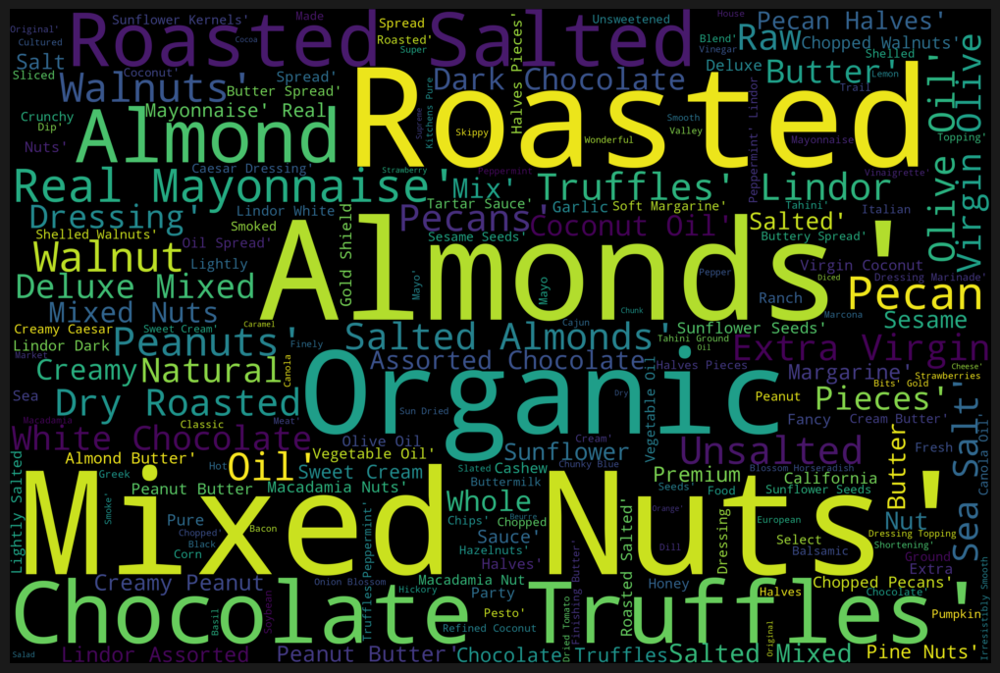

In [87]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_fat_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#### High sugar foods

Find sugary foods in the 98th percentile

In [88]:
high_sugar_df = df[df.sugars_100g > df.sugars_100g.quantile(.98)]
high_sugar_text = high_sugar_df['product'].values
len(high_sugar_text)

893

Word Cloud High Sugar

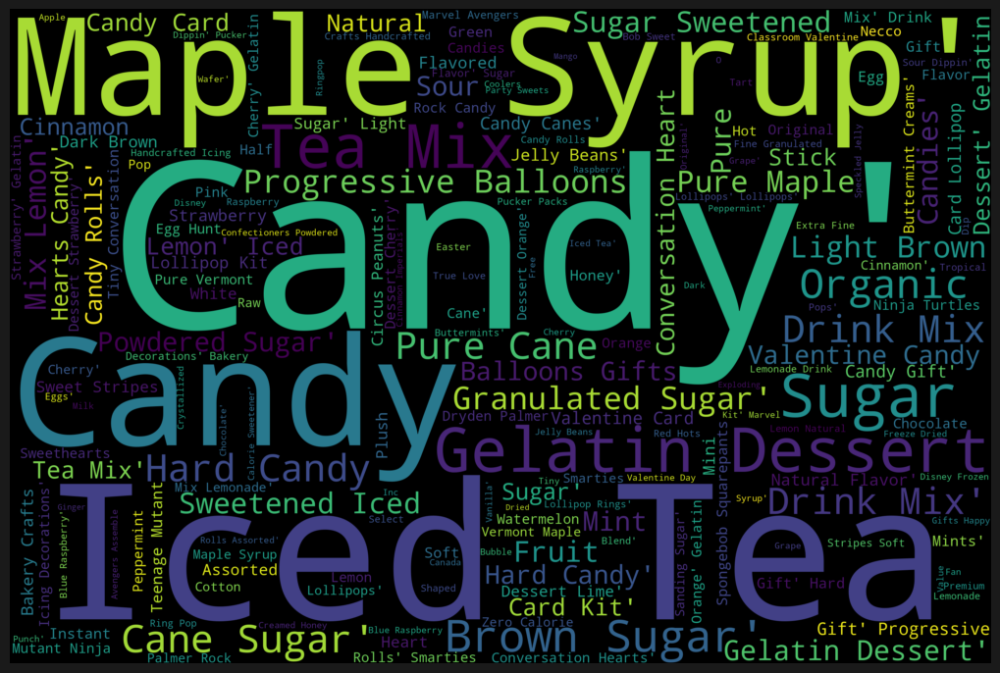

In [89]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_sugar_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

## Learn Natural Language Processing Libraries

### NLTK Stopword Processing


#### Setup Stop Words

In [90]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stop = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


#### Preprocess Text

In [91]:
dataset = df['product'].fillna("").values
raw_text_data = [d.split() for d in dataset]

#### Remove stop words


In [92]:
text_data = [item for item in raw_text_data if item not in stop]

### Gensim Topic Modeling

In [93]:
from gensim import corpora
dictionary = corpora.Dictionary(text_data)
corpus = [dictionary.doc2bow(text) for text in text_data]

In [94]:
import gensim
NUM_TOPICS = 5
ldamodel = gensim.models.ldamodel.LdaModel(
    corpus, num_topics = NUM_TOPICS, id2word=dictionary, passes=15)

topics = ldamodel.print_topics(num_words=4)
for topic in topics:
    print(topic)

(0, '0.050*"Cheese" + 0.033*"&" + 0.025*"Sauce" + 0.020*"Whole"')
(1, '0.032*"In" + 0.029*"Juice" + 0.025*"&" + 0.022*"Chicken"')
(2, '0.047*"Cream" + 0.034*"Candy" + 0.024*"Sour" + 0.022*"Style"')
(3, '0.051*"Beans" + 0.026*"Apple" + 0.025*"Green" + 0.024*"Fat"')
(4, '0.051*"Chocolate" + 0.041*"Mix" + 0.035*"&" + 0.029*"Milk"')
